## Cutty Bears

In [1]:
!pip install -Uqq fastai

In [2]:
from fastai.vision.all import *

In [4]:
!pip install bing-image-downloader

In [5]:
import os
from bing_image_downloader import downloader
from pathlib import Path

path = Path('images/bears')
bear_types = 'grizzly','black','teddy'

limit = 30 # Number of images to download for EACH keyword
output_directory = "images"

if not os.path.exists(output_directory):
    os.makedirs(output_directory)

print("--- Starting Image Download using Bing Image Downloader ---")

try:
    for keyword in bear_types:
        print(f"Downloading images for: {keyword}")
        downloader.download(
            f'{keyword} bear',
            limit=limit,
            output_dir=path,
            adult_filter_off=True,
            force_replace=False,
            timeout=60 # Timeout for each download operation
        )
    print("\n--- Download Complete ---")
    print(f"Downloaded files are located in: {output_directory}/")

except Exception as e:
    print(f"An error occurred during download: {e}")
    print("Please check your internet connection or try again later.")

--- Starting Image Download using Bing Image Downloader ---
[%] Downloading Images to /content/images/bears/grizzly bear


[!!]Indexing page: 1

[%] Indexed 72 Images on Page 1.


[%] Downloading Image #1 from https://cdn.britannica.com/19/186719-050-887A6F2C/Grizzly-bear-Rocky-Mountains-Wyoming.jpg
[%] File Downloaded !

[%] Downloading Image #2 from https://cdn.britannica.com/18/161718-050-2DB34DD6/Grizzly-bear.jpg
[%] File Downloaded !

[%] Downloading Image #3 from https://cdn.pixabay.com/photo/2018/06/19/04/44/grizzly-bear-3483887_1280.jpg
[%] File Downloaded !

[%] Downloading Image #4 from https://blog.nwf.org/wp-content/blogs.dir/11/files/2015/12/white-collar_Pat-Roque.jpg
[%] File Downloaded !

[%] Downloading Image #5 from https://facts.net/wp-content/uploads/2020/10/grizzly-bear-861962_1280.jpg
[%] File Downloaded !

[%] Downloading Image #6 from https://d3d0lqu00lnqvz.cloudfront.net/media/media/897b2e5d-6d4c-40fa-bbe8-6829455747e2.jpg
[%] File Downloaded !

[%] Downloading 

In [6]:
teddiesPath = path/'teddy bear'
teddies = get_image_files(teddiesPath)
teddies

(#27) [Path('images/bears/teddy bear/Image_1.jpg'),Path('images/bears/teddy bear/Image_18.png'),Path('images/bears/teddy bear/Image_16.jpg'),Path('images/bears/teddy bear/Image_4.jpg'),Path('images/bears/teddy bear/Image_19.jpg'),Path('images/bears/teddy bear/Image_12.jpg'),Path('images/bears/teddy bear/Image_28.jpg'),Path('images/bears/teddy bear/Image_26.jpg'),Path('images/bears/teddy bear/Image_23.jpg'),Path('images/bears/teddy bear/Image_13.jpg'),Path('images/bears/teddy bear/Image_9.jpg'),Path('images/bears/teddy bear/Image_2.jpg'),Path('images/bears/teddy bear/Image_3.jpeg'),Path('images/bears/teddy bear/Image_30.jpg'),Path('images/bears/teddy bear/Image_15.jpg'),Path('images/bears/teddy bear/Image_22.jpg'),Path('images/bears/teddy bear/Image_25.jpg'),Path('images/bears/teddy bear/Image_10.jpg'),Path('images/bears/teddy bear/Image_17.jpg'),Path('images/bears/teddy bear/Image_8.jpg')...]

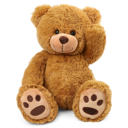

In [7]:
im = Image.open(teddies[0])
im.to_thumb(128,128)

In [8]:
images = get_image_files(path)
images

failed = verify_images(images)
failed

(#0) []

In [9]:
print(path)

bears = DataBlock(
    blocks=(ImageBlock, CategoryBlock),
    get_items=get_image_files,
    splitter=RandomSplitter(valid_pct=0.2, seed=42),
    get_y=parent_label,
    item_tfms=Resize(128))


images/bears


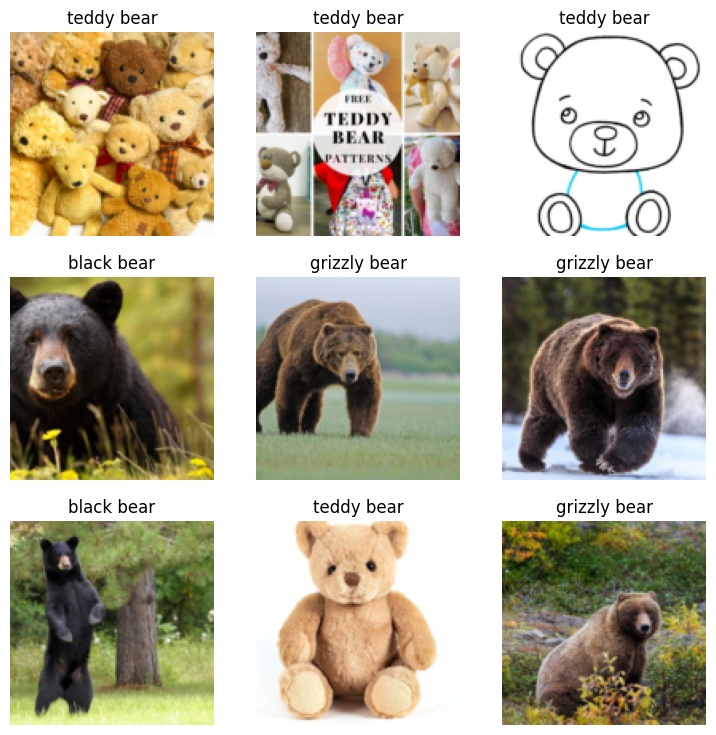

In [10]:
dls = bears.dataloaders(path)

dls.show_batch()

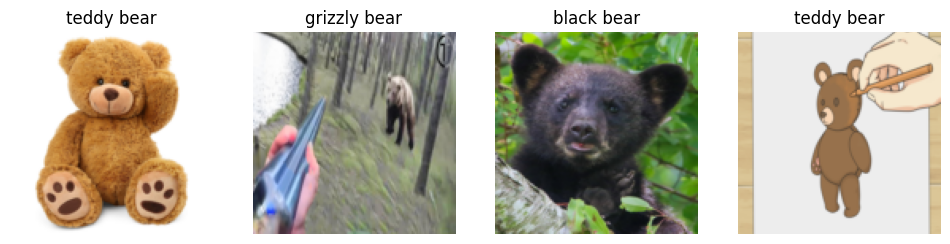

In [11]:
bears = bears.new(item_tfms=Resize(128, ResizeMethod.Squish))
dls = bears.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=1)

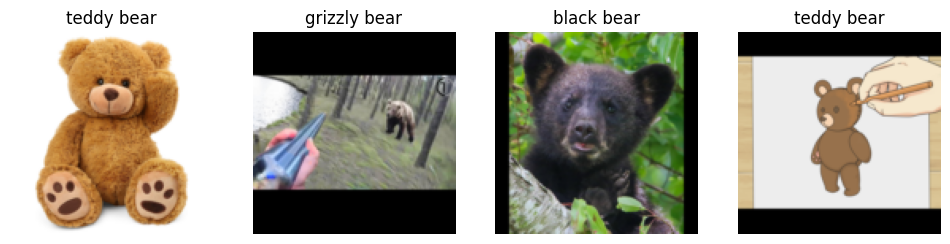

In [12]:
bears = bears.new(item_tfms=Resize(128, ResizeMethod.Pad, pad_mode='zeros'))
dls = bears.dataloaders(path)
dls.valid.show_batch(max_n=4, nrows=1)

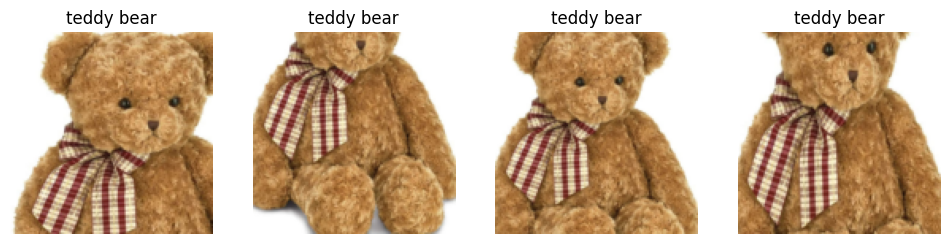

In [13]:
bears = bears.new(item_tfms=RandomResizedCrop(128, min_scale=0.3))
dls = bears.dataloaders(path)
dls.train.show_batch(max_n=4, nrows=1, unique=True)

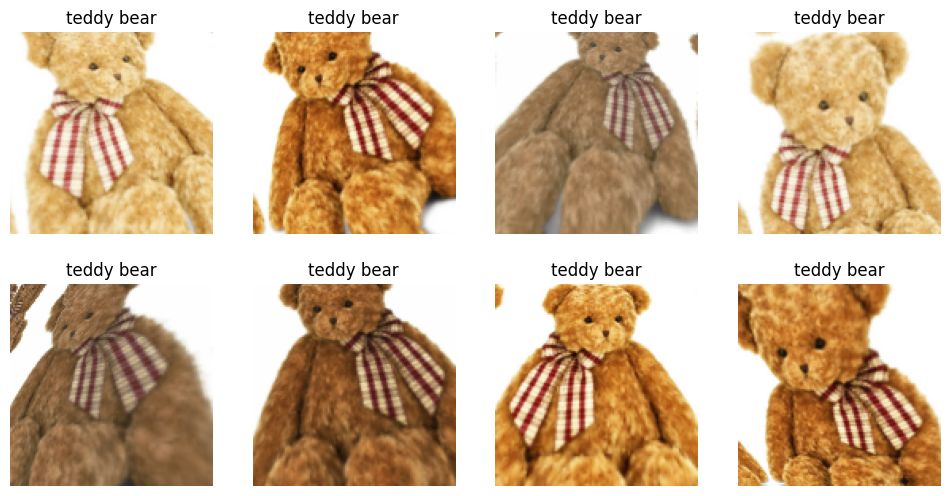

In [14]:
bears = bears.new(item_tfms=Resize(128), batch_tfms=aug_transforms(mult=2))
dls = bears.dataloaders(path)
dls.train.show_batch(max_n=8, nrows=2, unique=True)

In [15]:
bears = bears.new(
    item_tfms= RandomResizedCrop(224, min_scale=0.5),
    batch_tfms= aug_transforms())

dls = bears.dataloaders(path)

In [16]:
learn = vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


100%|██████████| 44.7M/44.7M [00:00<00:00, 175MB/s]


epoch,train_loss,valid_loss,error_rate,time
0,2.074064,1.975989,0.705882,00:18


epoch,train_loss,valid_loss,error_rate,time
0,1.609028,0.979442,0.529412,00:24
1,1.420679,0.206411,0.058824,00:24
2,1.098280,0.177682,0.058824,00:29
3,0.844502,0.175707,0.058824,00:30


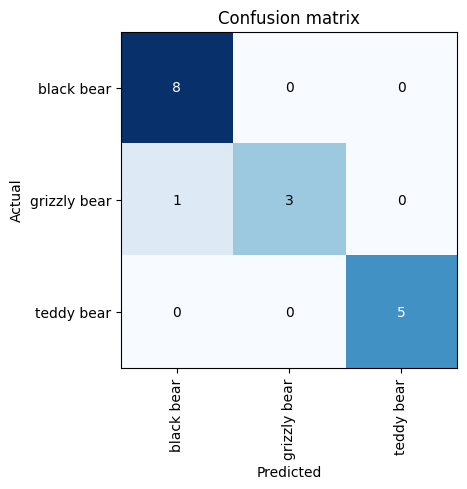

In [17]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

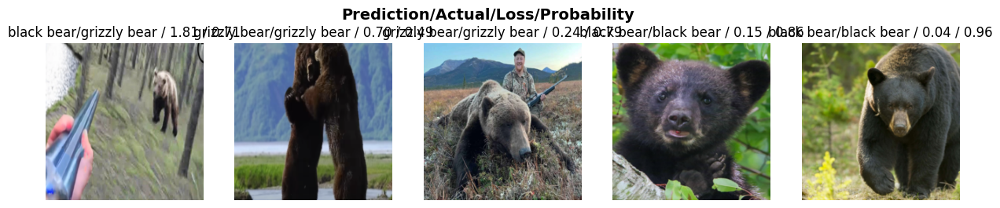

In [18]:
interp.plot_top_losses(5, nrows=1)

In [21]:
from fastai.vision.widgets import ImageClassifierCleaner

cleaner = ImageClassifierCleaner(learn)
cleaner

In [26]:
for idx in cleaner.delete():
  print(idx)
  cleaner.fns[idx].unlink()

for idx,cat in cleaner.change():
  print(idx)
  shutil.move(str(cleaner.fns[idx]), path/cat)

0
2


In [29]:
bears = bears.new(
    item_tfms= RandomResizedCrop(224, min_scale=0.5),
    batch_tfms= aug_transforms())

dls = bears.dataloaders(path)

learn = vision_learner(dls, resnet18, metrics=error_rate)
learn.fine_tune(4)

epoch,train_loss,valid_loss,error_rate,time
0,1.796684,5.310982,0.687500,00:19


epoch,train_loss,valid_loss,error_rate,time
0,1.836082,3.795150,0.687500,00:24
1,1.573781,1.930192,0.625000,00:25
2,1.137733,0.635922,0.312500,00:24
3,0.864098,0.278643,0.187500,00:24


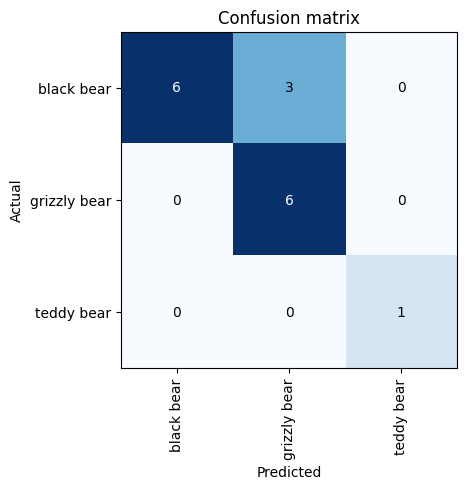

In [30]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix()

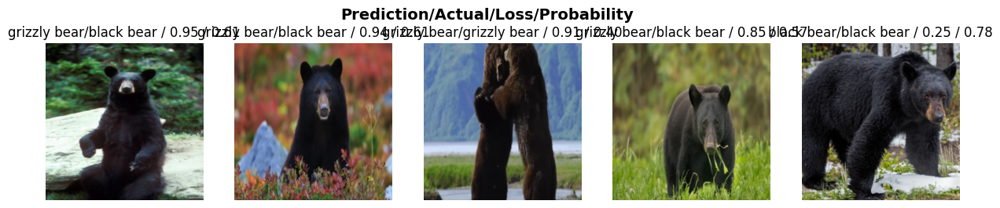

In [31]:
interp.plot_top_losses(5, nrows=1)

In [40]:
path = Path()
path.ls(file_exts='.pkl')

(#1) [Path('model.pkl')]

In [34]:
learn.export('model.pkl')

In [41]:
learn_inf = load_learner('model.pkl')


In [43]:
learn_inf.predict('images/bears/teddy bear/Image_1.jpg')

('teddy bear', tensor(2), tensor([9.8671e-06, 4.4753e-04, 9.9954e-01]))

In [44]:
learn_inf.dls.vocab

['black bear', 'grizzly bear', 'teddy bear']

In [46]:
import ipywidgets as widgets

btn_upload = widgets.FileUpload()
btn_upload

FileUpload(value={}, description='Upload')

In [49]:
btn_upload = SimpleNamespace(data = ['images/bears/teddy bear/Image_12.jpg'])

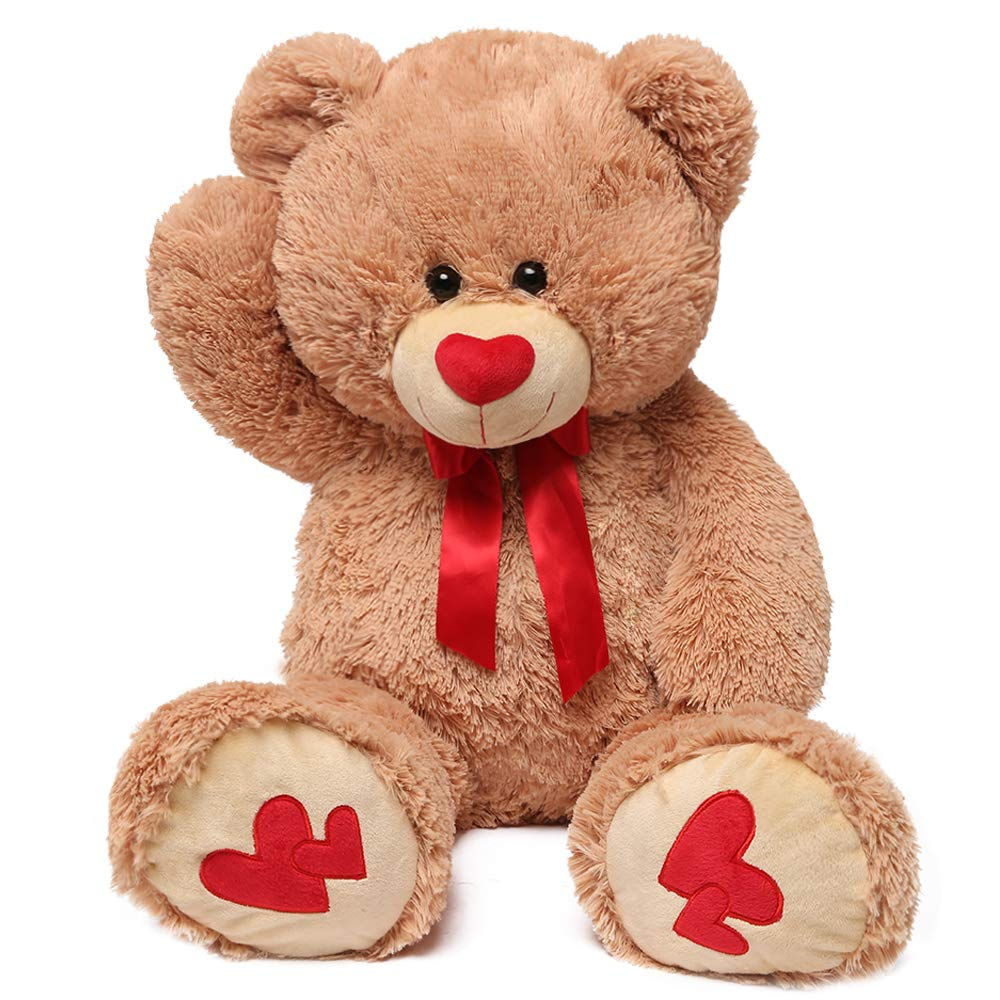

In [52]:
img = PILImage.create(btn_upload.data[-1])
img

In [53]:
out_pl = widgets.Output()
out_pl.clear_output()
with out_pl: display(img.to_thumb(128,128))
out_pl

Output()

In [55]:
pred,pred_idx,probs = learn_inf.predict(img)
pred,pred_idx,probs

('teddy bear', tensor(2), tensor([1.0480e-06, 7.3782e-06, 9.9999e-01]))

In [56]:
lbl_pred = widgets.Label()
lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'
lbl_pred

Label(value='Prediction: teddy bear; Probability: 1.0000')

In [64]:
import ipywidgets as widgets
from ipywidgets import VBox

btn_upload = widgets.FileUpload()

btn_run = widgets.Button(description='Classify')

def on_click_classify(change):
    img = PILImage.create(btn_upload.data[-1])
    out_pl.clear_output()
    with out_pl: display(img.to_thumb(128,128))
    pred,pred_idx,probs = learn_inf.predict(img)
    lbl_pred.value = f'Prediction: {pred}; Probability: {probs[pred_idx]:.04f}'

btn_run.on_click(on_click_classify)

VBox([widgets.Label('Select your bear!'),
      btn_upload, btn_run, out_pl, lbl_pred])

In [65]:
!pip install voila
!jupyter serverextension enable --sys-prefix voila

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 101.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.8/59.8 kB 4.8 MB/s eta 0:00:00
Enabling: voila
- Writing config: /usr/etc/jupyter
    - Validating...
      voila 0.5.11 OK
